In [1]:
#From Pre-Processing:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
#from library.sb_utils import save_file
data = pd.read_csv('phishing_data.csv')
class1 = data[data['CLASS_LABEL'] == 0] #Class one, I believe, describes phishing websites; '0' corresponds to 
#'False' and the original csv was named 'Legitimate websites' - This is my reasoning
class2 = data[data['CLASS_LABEL'] == 1]

categorical = ['SubdomainLevelRT', 'UrlLengthRT', 'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT', 
               'PctExtNullSelfRedirectHyperlinksRT'] #changed - now just the '-1, 0, 1' columns.
binary = ['AtSymbol', 'TildeSymbol', 'NumHash', 'NoHttps' 'RandomString', 'IpAddress', 'DomainInSubdomains', 
          'DomainInPaths', 'DoubleSlashInPath', 'EmbeddedBrandName', 'ExtFavicon', 'InsecureForms', 
          'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction', 'FrequentDomainNameMismatch',
          'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow','SubmitInfoToEmail', 'IframeOrFrame', 
          'MissingTitle', 'ImagesOnlyInForm','CLASS_LABEL']
percentages = ['PctNullSelfRedirectHyperlinks', 'PctExtHyperlinks', 'PctExtResourceUrls']
#I identified two columns to be dropped completely: id and HttpsInHostname. 

one_hot_data = pd.get_dummies(data, columns=categorical)
#print(one_hot_data.head())

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
data = data.drop(['id','HttpsInHostname'], axis=1)
data_columns = data.columns

#scaling up here so that it's applied to everything together before the X and y are split off - apparently the problem
#is that this makes a numpy array

#scaler = StandardScaler().fit(data)
#data_scaled = pd.DataFrame(scaler.transform(data), columns = data_columns)

#Realized this is unnecessary because y refers to a binary column.

X = data.drop(['CLASS_LABEL'],axis =1)
X_cols = X.columns
y = data['CLASS_LABEL']
y_col = 'CLASS_LABEL'
scaler = StandardScaler().fit(X)
X_scaled = scaler.transform(X)
#The above is only the fit and transformation for the unsupervised trial - redone below for test/train split

Text(0, 0.5, 'Sum of Squares')

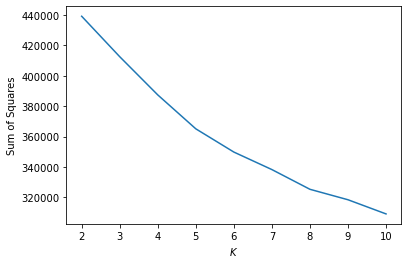

In [2]:
#Okay not to use training and testing split on this unsupervised trial

# trying clustering first -
import sklearn.cluster
import numpy as np

# Make an empty list
ss = []

# Make an empty dictionary called assignments 
assignments = {}

# Make a variable called Krange, and assign it a list of range(2, 11)
Krange  = list(range(2, 11))

# We now want to iterate through this list to construct a plot showing SS for each K. Name the iterator variable K 
for K in Krange:
    # Make a variable called model, and assign it the result of calling sklearn.cluster.KMeans, with n_clusters = K 
    model = sklearn.cluster.KMeans(n_clusters= K)
    assigned_cluster = model.fit_predict(X_scaled) # should be all but the class variable
    centers = model.cluster_centers_
    ss.append(np.sum((X_scaled - centers[assigned_cluster]) ** 2))
    assignments[str(K)] = assigned_cluster
    
# Call plot() on plt with parameters Krange and ss
plt.plot(Krange, ss)

# Let's label the plot 
plt.xlabel("$K$")
plt.ylabel("Sum of Squares")

# Can you see what we're doing here? - We are looking for the best value to give K

0.13650494404663602 2
0.12687057304689414 3
0.11315683636154299 4
0.11107652074300113 5
0.12163997352063348 6
0.12462394368286746 7
0.12932179696648258 8
0.12910861644019772 9
0.1293953578645155 10


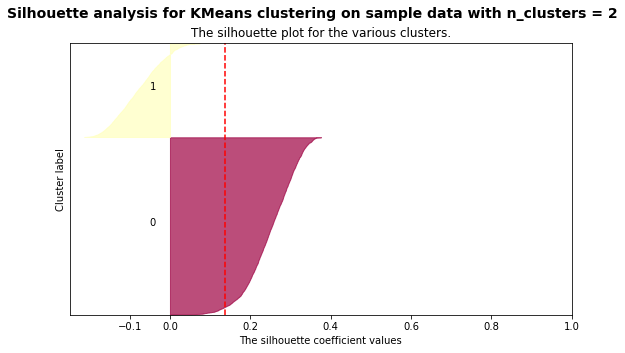

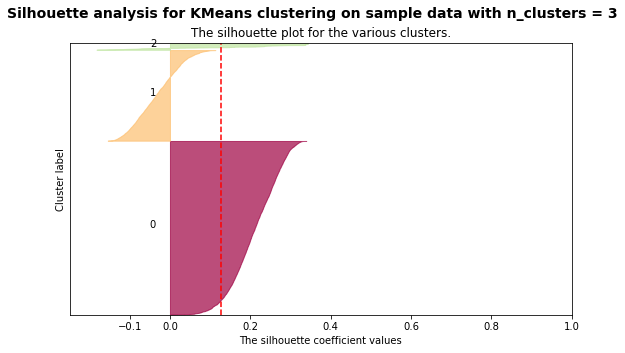

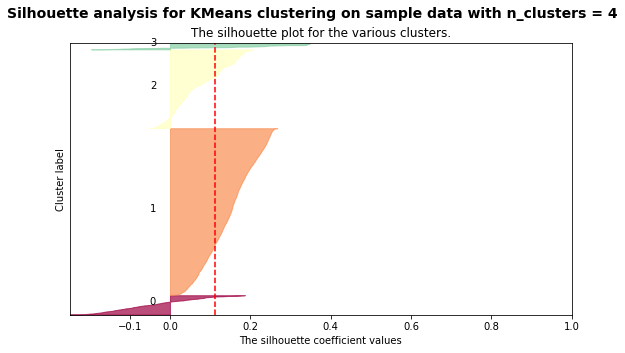

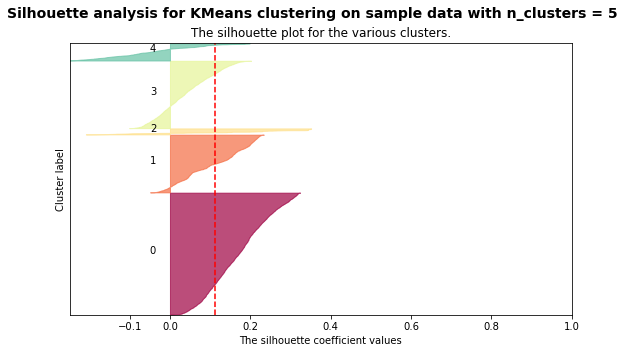

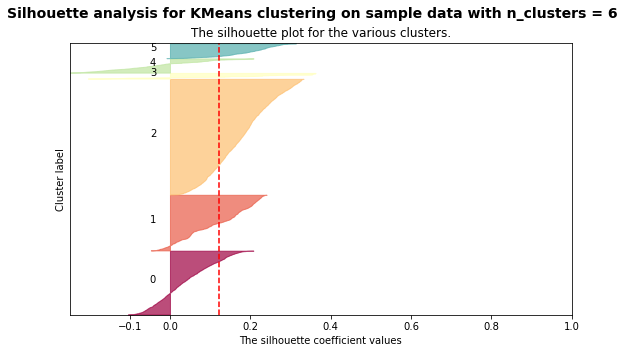

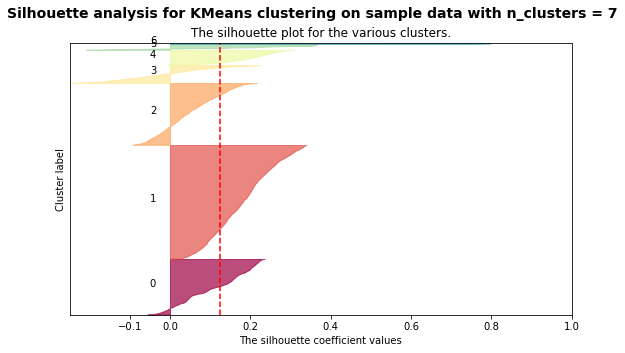

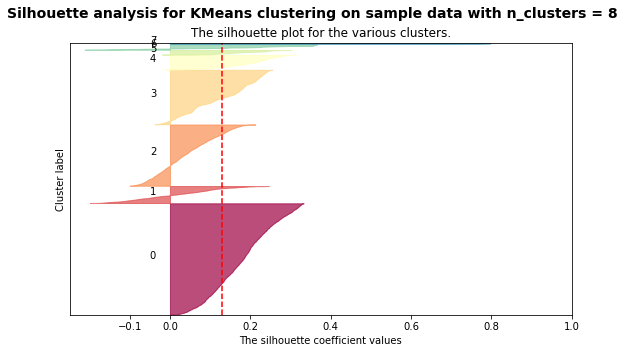

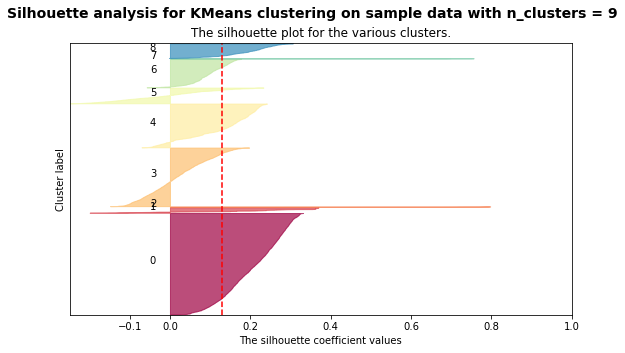

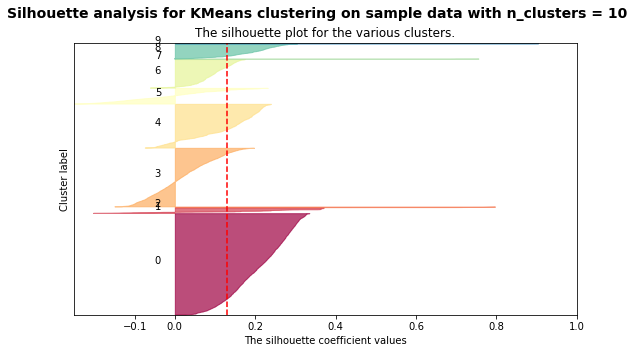

In [3]:
import sklearn.metrics
import matplotlib.cm as cm

# Make an empty list called avg_silhouette_scores
avg_silhouette_scores = []

# Iterate through Krange with variable K as before
for K in Krange:
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(9, 5)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    # Call set_xlim on ax1 
    ax1.set_xlim([-0.25, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X_scaled) + (K + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = sklearn.cluster.KMeans(n_clusters=K, random_state=10)
    cluster_labels = clusterer.fit_predict(X_scaled)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    # Make a variable called silhouette_avg. Set the parameters to silhouette_score to X, and cluster_labels
    silhouette_avg  = sklearn.metrics.silhouette_score(X_scaled, cluster_labels)
    print(silhouette_avg, K)
    avg_silhouette_scores.append(silhouette_avg)
 # Compute the silhouette scores for each sample
    # Call sklearn.metrics.silhouette_samples with the below parameters
    sample_silhouette_values = sklearn.metrics.silhouette_samples(X_scaled, cluster_labels) #
    y_lower = 10
    for i in range(K):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        # Make a variable called ith_cluster_silhouette_values
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        # Call sort() on this variable 
        ith_cluster_silhouette_values.sort()
    
        # Call shape[0] on ith_cluster_silhouette_values 
        size_cluster_i = ith_cluster_silhouette_values.shape[0] 
        y_upper = y_lower + size_cluster_i

        cmap = cm.get_cmap("Spectral")
        color = cmap(float(i) / K)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        # This requires calling text() on ax1 
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    # Setting title, xlabel and ylabel 
    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    # This requires axvline() 
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % K),
    fontsize=14, fontweight='bold')
    #2 clusters got a silhouette score of .5+ when the data was unscaled, still relatively the best

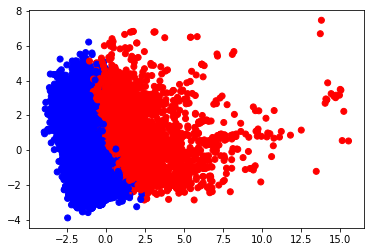

In [5]:
import sklearn.decomposition
import matplotlib.colors

# Make a variable called model. We want n_clusters = 3 as parameter to sklearn.cluster.KMeans 
model = sklearn.cluster.KMeans(n_clusters=2)
# Call a fit_predict() on X 
cluster_assignments = model.fit_predict(X_scaled)

# Let's visualiaze with colors.ListedColormap
cmap = matplotlib.colors.ListedColormap(['red', 'green', 'blue'])

# We're going to do some PCA here. Call decomposition.PCA on sklearn, and pass n_components=2 as parameter
pca = sklearn.decomposition.PCA(n_components=2)
pc1, pc2 = zip(*pca.fit_transform(X_scaled))
plt.scatter(pc1, pc2, c=cluster_assignments.tolist(), cmap=cmap)

In [6]:
#I guess the above wasn't really necessary since I think that would be about identifying clusters 
#and we already know we want to split these into two - but I was curious what it would do.

Text(0, 0.5, 'Proportion of Variance Explained')

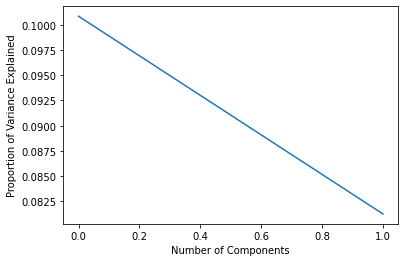

In [6]:
import sklearn.decomposition
# Initialize a variable, called pca, and assign it sklearn.decomposition.PCA() 
pace = sklearn.decomposition.PCA()

# Call fit() on pca, with X passed to the method
pca.fit(X_scaled)

# Let's finish this :)  Make a variable called variance
variance = pca.explained_variance_ratio_

# Plot() it 
plt.plot(range(len(variance)), variance)

# Label the axes
plt.xlabel("Number of Components")
plt.ylabel("Proportion of Variance Explained")

In [9]:
#Now Random Forest
# Model (can also use single decision tree)
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=10)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=1)
scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

#I think I lifted this example from one of the exercies - so it's probably correct. I should be fitting the scaler 
#with the training data and then transforming both the testing and training based on this fit
#PROBABLY VERY IMPORTANT

# Train
model.fit(X_train_scaled, y_train) #Is this right?
# Extract single tree
estimator = model.estimators_[5]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_cols,
                class_names = y_col,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

In [11]:
#WHOA - wonder how I can make that easier to read
import os
import pandas as pd
from datetime import datetime,timedelta
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
import plotly.graph_objects as go
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.linear_model import LogisticRegression
from matplotlib import pyplot
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,roc_auc_score
from sklearn.metrics import accuracy_score,log_loss
from matplotlib import pyplot

from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(n_estimators=300, random_state = 1,n_jobs=-1)
model_res = clf.fit(X_train_scaled, y_train)
y_pred = model_res.predict(X_test_scaled)
y_pred_prob = model_res.predict_proba(X_test_scaled)
lr_probs = y_pred_prob[:,1]
ac = accuracy_score(y_test, y_pred)

f1 = f1_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print('Random Forest: Accuracy=%.3f' % (ac))

print('Random Forest: f1-score=%.3f' % (f1))

Random Forest: Accuracy=0.983
Random Forest: f1-score=0.983


Confusion matrix, without normalization
[[ 963   16]
 [  18 1003]]
Normalized confusion matrix
[[0.98 0.02]
 [0.02 0.98]]


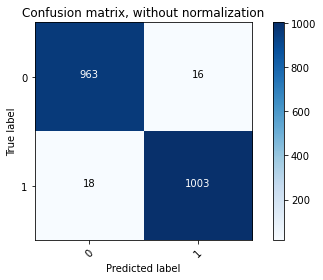

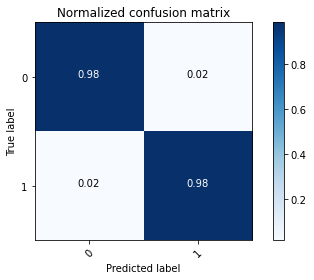

In [13]:
import itertools
import numpy as np
import matplotlib.pyplot as plt

from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()


# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=[0,1],#I'm still confused by how these labels can possibly align correctly -
#I switched the order and it flipped the value, so I'm not sure how to make this actually works
#THIS REMAINS AN UNSOLVED PROBLEM - WON'T RUN WITHOUT THE CLASSES
                      title='Confusion matrix, without normalization')
#plt.savefig('figures/RF_cm_multi_class.png')

# Plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=[0,1], normalize=True,
                      title='Normalized confusion matrix')
#plt.savefig('figures/RF_cm_proportion_multi_class.png', bbox_inches="tight")
plt.show()

30


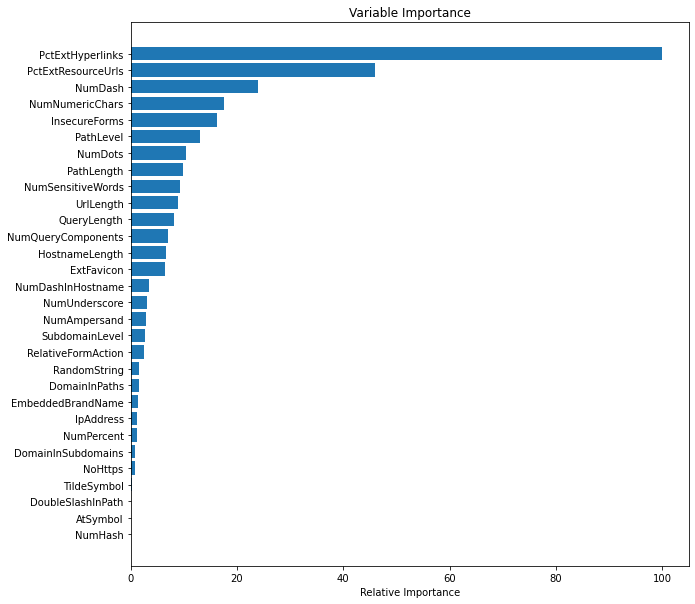

In [14]:
feature_importance = clf.feature_importances_
# make importances relative to max importance
feature_importance = 100.0 * (feature_importance / feature_importance.max())[:30]
sorted_idx = np.argsort(feature_importance)[:30]

pos = np.arange(sorted_idx.shape[0]) + .5
print(pos.size)
sorted_idx.size
plt.figure(figsize=(10,10))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.show()

In [17]:
#I still have some questions on random forest but it seems to work well with the dataset
#On to KNN
#In the example I looked At, it didn't show the scores based on the scaled values, not sure if this is correct or not
from sklearn.neighbors import KNeighborsClassifier


test_scores = []
train_scores = []

for i in range(1,10):

    knn = KNeighborsClassifier(i)
    knn.fit(X_train_scaled,y_train)
    
    train_scores.append(knn.score(X_train_scaled, y_train))
    test_scores.append(knn.score(X_test_scaled, y_test))

In [18]:
print("test_scores", test_scores)
print("train_score", train_scores)
#This seems to be returning very positive results too - scaling appears to have helped a lot

test_scores [0.9625, 0.9545, 0.9575, 0.9515, 0.95, 0.9445, 0.9475, 0.9445, 0.9425]
train_score [1.0, 0.981125, 0.973875, 0.965625, 0.962375, 0.958875, 0.95875, 0.955625, 0.9535]


/Users/elizabethrogers/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/elizabethrogers/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


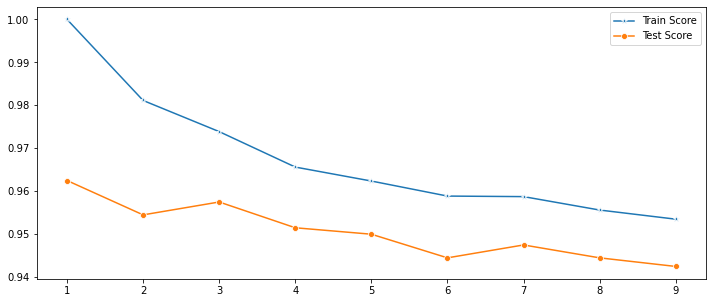

In [19]:
plt.figure(figsize=(12,5))
p = sns.lineplot(range(1,10),train_scores,marker='*',label='Train Score')
p = sns.lineplot(range(1,10),test_scores,marker='o',label='Test Score')

In [20]:
#I need to ask if I'm interpreting correctly here - I feel like 1 would be overfitting even though its test score is
#still better.
knn2 = KNeighborsClassifier(3) #Am I allowed to do this with actual data sets - use the test data to choose the best 
#hyperparameters?
knn2.fit(X_train_scaled,y_train)
    
print('train_score', knn2.score(X_train_scaled,y_train))
print('test_score', knn2.score(X_test_scaled,y_test))
#Scaling has improved this a lot

train_score 0.973875
test_score 0.9575


Confusion matrix, without normalization
[[935  44]
 [ 41 980]]
Normalized confusion matrix
[[0.96 0.04]
 [0.04 0.96]]


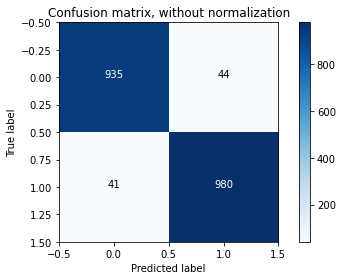

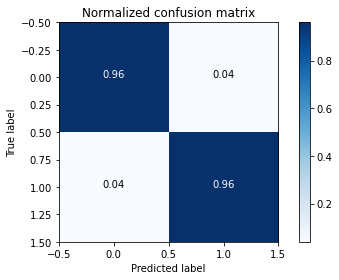

In [21]:
from sklearn.metrics import confusion_matrix
y_pred = knn2.predict(X_test_scaled)
pl = confusion_matrix(y_test,y_pred)
from sklearn.metrics import confusion_matrix
class_names='Outcome' #It seems like this is irrevelant/counterproductive when plotting a confusion matrix that isn't
#plotting alignment to categories
def plot_confusion_matrix(pl, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        pl = pl.astype('float') / pl.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(pl) 

    plt.imshow(pl, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
   # tick_marks = np.arange(len(classes))
    #plt.xticks(tick_marks, classes, rotation=45)
   # plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = pl.max() / 2.
    for i, j in itertools.product(range(pl.shape[0]), range(pl.shape[1])):
        plt.text(j, i, format(pl[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if pl[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()


# Something that was in the example
#np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(pl, classes=[0,1],
                      title='Confusion matrix, without normalization')
#plt.savefig('figures/RF_cm_multi_class.png')

# Plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(pl, classes=[0,1], normalize=True,
                      title='Normalized confusion matrix')
#plt.savefig('figures/RF_cm_proportion_multi_class.png', bbox_inches="tight")
plt.show()

In [22]:
from sklearn.metrics import classification_report
cr = classification_report(y_test, y_pred)
print(cr)

              precision    recall  f1-score   support

           0       0.96      0.96      0.96       979
           1       0.96      0.96      0.96      1021

    accuracy                           0.96      2000
   macro avg       0.96      0.96      0.96      2000
weighted avg       0.96      0.96      0.96      2000



In [23]:
from sklearn.model_selection import GridSearchCV
param_grid = {'n_neighbors':np.arange(1,50)}
knn = KNeighborsClassifier()
knn_cv= GridSearchCV(knn,param_grid,cv=5)
knn_cv.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49])})

In [24]:
print("Best Score:" + str(knn_cv.best_score_))
print("Best Parameters: " + str(knn_cv.best_params_)) 
#See this likes #1 too - I might be wrong in my interpretation

Best Score:0.9536250000000001
Best Parameters: {'n_neighbors': 1}


In [25]:
param_grid = {'n_estimators':np.arange(1,500,50)}
rfc = RandomForestClassifier()
rfc_cv= GridSearchCV(rfc,param_grid,cv=5)
rfc_cv.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'n_estimators': array([  1,  51, 101, 151, 201, 251, 301, 351, 401, 451])})

In [26]:
print("Best Score:" + str(rfc_cv.best_score_))
print("Best Parameters: " + str(rfc_cv.best_params_))
#Oh wow - even better than 300! Good to know! Probably the best model.

Best Score:0.984625
Best Parameters: {'n_estimators': 451}


In [28]:
#Now trying a decision tree rather than random forest:
from sklearn import tree, metrics
import seaborn as sns
from io import StringIO  
from IPython.display import Image  
import pydotplus
# Declare a variable called entr_model and use tree.DecisionTreeClassifier. 
entr_model = tree.DecisionTreeClassifier(criterion="entropy", random_state = 1234)

# Call fit() on entr_model
entr_model.fit(X_train_scaled, y_train)

# Call predict() on entr_model with X_test passed to it, and assign the result to a variable y_pred 
y_pred = entr_model.predict(X_test_scaled)

# Call Series on our y_pred variable with the following: pd.Series(y_pred)
y_pred = pd.Series(y_pred)

# Check out entr_model
entr_model

DecisionTreeClassifier(criterion='entropy', random_state=1234)

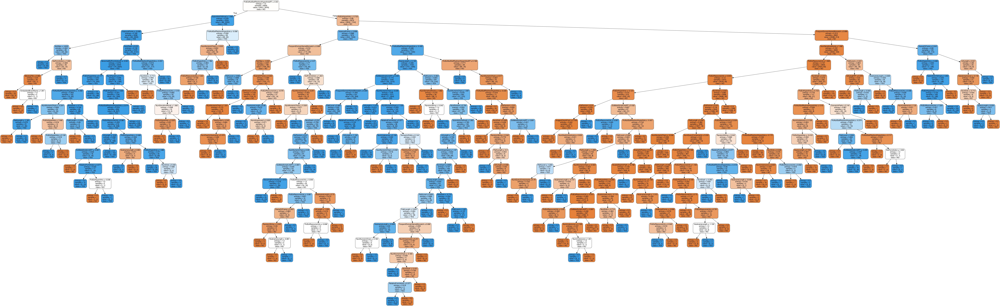

In [34]:
# Now we want to visualize the tree
dot_data = StringIO()

# We can do so with export_graphviz
tree.export_graphviz(entr_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_cols,class_names = ["NO","YES"]) 

# Alternatively for class_names use entr_model.classes_
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [35]:
# Run this block for model evaluation metrics 
from sklearn.model_selection import train_test_split
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes"' , metrics.precision_score(y_test,y_pred, pos_label = 1))
print('Precision score for "No"' , metrics.precision_score(y_test,y_pred, pos_label = 0))
print('Recall score for "Yes"' , metrics.recall_score(y_test,y_pred, pos_label = 1))
print('Recall score for "No"' , metrics.recall_score(y_test,y_pred, pos_label = 0)) #Changed yeses to 1s and nos to 0s

Model Entropy - no max depth
Accuracy: 0.9625
Balanced accuracy: 0.9623468949806865
Precision score for "Yes" 0.9574468085106383
Precision score for "No" 0.9679089026915114
Recall score for "Yes" 0.9696376101860921
Recall score for "No" 0.9550561797752809


In [36]:
# Make a variable called gini_model, and assign it exactly what you assigned entr_model with above, but with the
# criterion changed to 'gini'
gini_model = tree.DecisionTreeClassifier(criterion="gini", random_state = 1234) 

# Call fit() on the gini_model as you did with the entr_model
gini_model.fit(X_train_scaled, y_train)

# Call predict() on the gini_model as you did with the entr_model 
y_pred = gini_model.predict(X_test_scaled)

# Turn y_pred into a series, as before
y_pred = pd.Series(y_pred)

# Check out gini_model
gini_model

DecisionTreeClassifier(random_state=1234)

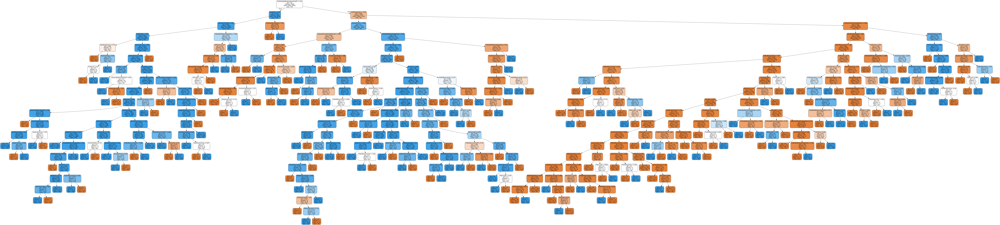

In [37]:
# As before, but make the model name gini_model
dot_data = StringIO()
tree.export_graphviz(gini_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_cols,class_names = ["NO", "YES"])

# Alternatively for class_names use gini_model.classes_
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [38]:
# Run this block for model evaluation
print("Model Gini impurity model")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = 1))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = 0))

Model Gini impurity model
Accuracy: 0.9655
Balanced accuracy: 0.9655162926850741
Precision score 0.9675834970530451
Recall score 0.9662921348314607


In [42]:
#I'm somewhat confused about whether my y values are matching up with yes and no correctly and I'm not
#getting scores as good as my random forest model so I'm going to move on to Gradient Boosting
from sklearn import preprocessing
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc

learning_rates = [0.05, 0.1, 0.25, 0.5, 0.75, 1]
for learning_rate in learning_rates:
    gb = GradientBoostingClassifier(n_estimators=20, learning_rate = learning_rate, max_features=2, max_depth = 2, random_state = 0)
    gb.fit(X_train_scaled, y_train)
    print("Learning rate: ", learning_rate)
    print("Accuracy score (training): {0:.3f}".format(gb.score(X_train_scaled, y_train)))
    print("Accuracy score (validation): {0:.3f}".format(gb.score(X_test_scaled, y_test)))
    print()
    
gb = GradientBoostingClassifier(n_estimators=20, learning_rate = 1, max_features=2, max_depth = 2, random_state = 0)
gb.fit(X_train_scaled, y_train)
y_pred = gb.predict(X_test_scaled)
print("Confusion matrix: ", confusion_matrix(y_test, y_pred))
print("Classification report: ", classification_report(y_test, y_pred))

y_scores_gb = gb.decision_function(X_test_scaled)
fpr_gb, tpr_gb, _ = roc_curve(y_test, y_scores_gb)
roc_auc_gb = auc(fpr_gb, tpr_gb)
print("Area under ROC: ", roc_auc_gb)
#I'm not sure whether I did this optimally but it performed better than the Titanic example did - 
#seems like an extremely high ROC

Learning rate:  0.05
Accuracy score (training): 0.934
Accuracy score (validation): 0.918

Learning rate:  0.1
Accuracy score (training): 0.930
Accuracy score (validation): 0.918

Learning rate:  0.25
Accuracy score (training): 0.954
Accuracy score (validation): 0.936

Learning rate:  0.5
Accuracy score (training): 0.958
Accuracy score (validation): 0.952

Learning rate:  0.75
Accuracy score (training): 0.959
Accuracy score (validation): 0.954

Learning rate:  1
Accuracy score (training): 0.964
Accuracy score (validation): 0.954

Confusion matrix:  [[929  50]
 [ 42 979]]
Classification report:                precision    recall  f1-score   support

           0       0.96      0.95      0.95       979
           1       0.95      0.96      0.96      1021

    accuracy                           0.95      2000
   macro avg       0.95      0.95      0.95      2000
weighted avg       0.95      0.95      0.95      2000

Area under ROC:  0.9861653989409329


In [43]:
#Finally, a Baysian model:
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
import lightgbm
from bayes_opt import BayesianOptimization
from catboost import CatBoostClassifier, cv, Pool
import os
os.listdir()

['phishing_data.csv',
 'Modeling.ipynb',
 'tree.png',
 '.ipynb_checkpoints',
 '.git',
 'tree.dot']

In [44]:
def lgb_eval(num_leaves,max_depth,lambda_l2,lambda_l1,min_child_samples, min_data_in_leaf):
    params = {
        "objective" : "binary",
        "metric" : "auc", 
        'is_unbalance': True,
        "num_leaves" : int(num_leaves),
        "max_depth" : int(max_depth),
        "lambda_l2" : lambda_l2,
        "lambda_l1" : lambda_l1,
        "num_threads" : 20,
        "min_child_samples" : int(min_child_samples),
        'min_data_in_leaf': int(min_data_in_leaf),
        "learning_rate" : 0.03,
        "subsample_freq" : 5,
        "bagging_seed" : 42,
        "verbosity" : -1
    }
    lgtrain = lightgbm.Dataset(X_train_scaled, y_train)
    cv_result = lightgbm.cv(params,
                       lgtrain,
                       1000,
                       early_stopping_rounds=100,
                       stratified=True,
                       nfold=3)
    return cv_result['auc-mean'][-1]

In [45]:
lgbBO = BayesianOptimization(lgb_eval, {'num_leaves': (25, 4000),
                                                'max_depth': (5, 63),
                                                'lambda_l2': (0.0, 0.05),
                                                'lambda_l1': (0.0, 0.05),
                                                'min_child_samples': (50, 10000),
                                                'min_data_in_leaf': (100, 2000)
                                                })

lgbBO.maximize(n_iter=10, init_points=2)

|   iter    |  target   | lambda_l1 | lambda_l2 | max_depth | min_ch... | min_da... | num_le... |
-------------------------------------------------------------------------------------------------
[LightGBM] [Warning] min_data_in_leaf is set=1776, min_child_samples=5134 will be ignored. Current value: min_data_in_leaf=1776
|  1        |  0.97     |  0.01348  |  0.04721  |  13.99    |  5.134e+0 |  1.777e+0 |  107.7    |
|  2        |  0.9688   |  0.02248  |  0.007188 |  45.95    |  7.31e+03 |  1.823e+0 |  687.8    |
|  3        |  0.9943   |  0.02312  |  0.008945 |  60.36    |  9.229e+0 |  982.6    |  2.392e+0 |
|  4        |  0.9939   |  0.04068  |  0.04551  |  30.47    |  2.995e+0 |  995.4    |  304.0    |
|  5        |  0.99     |  0.04339  |  0.0417   |  32.36    |  9.484e+0 |  1.093e+0 |  2.875e+0 |
|  6        |  0.9954   |  0.004131 |  0.007152 |  20.65    |  9.171e+0 |  913.0    |  2.386e+0 |
|  7        |  0.9912   |  0.03624  |  0.02151  |  57.11    |  9.529e+0 |  1.064e+0 |  2

In [46]:
print(lgbBO.max) # - These results seem very good. Is this better than the Random Forest one? That was .98 something.
#(I'm assuming the .998 is an accuracy score - seems crazy high)

{'target': 0.9984729127005812, 'params': {'lambda_l1': 0.047775426339069525, 'lambda_l2': 0.03511638854971803, 'max_depth': 20.531301882117674, 'min_child_samples': 9355.96304070501, 'min_data_in_leaf': 189.41792085664542, 'num_leaves': 3269.210331494155}}


In [47]:
print(lgbBO.res[0]) #Oh I see - this would show each individually

{'target': 0.9700253322808688, 'params': {'lambda_l1': 0.013478095736917673, 'lambda_l2': 0.04721177237303519, 'max_depth': 13.989129628417954, 'min_child_samples': 5134.433149498962, 'min_data_in_leaf': 1776.6838300762624, 'num_leaves': 107.65441403242416}}
